# Applying `MCube` to the 3D *Drosophila* embryo model

In [1]:
set.seed(20240709)

library(MCube)
library(ggplot2)

max_cores <- 36

In [2]:
DATA_PATH <- "/import/home/share/zw/pql/data/Drosophila_embryo"
RESULT_PATH <- "/import/home/share/zw/pql/results/Drosophila_embryo"

if (!dir.exists(RESULT_PATH)) {
    dir.create(RESULT_PATH, recursive = TRUE)
}

In [3]:
n_slices <- 13
slice_idx_seq <- c(1:13)

reference_ST <- data.matrix(
    read.csv(file.path(DATA_PATH, "reference_ST.csv"),
        header = TRUE, row.names = 1, check.names = FALSE
    )
)
dim(reference_ST)
num_celltypes <- nrow(reference_ST)

proportions_ST <- matrix(, nrow = 0, ncol = num_celltypes)
batch_id <- vector("character")
for (slice_idx in slice_idx_seq) {
    proportions_i <- as.matrix(read.csv(
        file.path(
            DATA_PATH,
            paste0("prop_slice", slice_idx - 1, ".csv")
        ),
        header = TRUE, row.names = 1, check.names = FALSE
    ))
    proportions_ST <- rbind(proportions_ST, proportions_i)
    batch_id <- c(batch_id, rep(paste0("slice", slice_idx - 1), nrow(proportions_i)))
}
dim(proportions_ST)
num_spots <- nrow(proportions_ST)
spots <- rownames(proportions_ST)
names(batch_id) <- spots

counts <- as.data.frame(readr::read_csv(
    file.path(DATA_PATH, "counts.csv")
))
rownames(counts) <- counts[, 1]
counts[, 1] <- NULL
counts <- counts[spots, ]
counts <- data.matrix(counts)
dim(counts)

coordinates <- data.matrix(read.csv(
    file.path(DATA_PATH, "3D_coordinates.csv"),
    header = TRUE, row.names = 1, check.names = FALSE
))
coordinates <- coordinates[spots, ]
dim(coordinates)

spot_effects_ST <- data.matrix(read.csv(
    file.path(DATA_PATH, "spot_effects_ST.csv"),
    header = TRUE, row.names = 1, check.names = FALSE
))[spots, 1]

platform_effects_ST <- data.matrix(read.csv(
    file.path(DATA_PATH, "platform_effects_ST.csv"),
    header = TRUE, row.names = 1, check.names = FALSE
))

library_sizes_ST <- data.matrix(read.csv(
    file.path(DATA_PATH, "library_sizes_ST.csv"),
    header = TRUE, row.names = 1, check.names = FALSE
))[spots, 1]

[1]   16 5838

[1] 14132    16

New names:
• `` -> `...1`
Rows: 14132 Columns: 5839
── Column specification ────────────────────────────────────────────────────────
Delimiter: ","
chr    (1): ...1
dbl (5838): 14-3-3epsilon, 14-3-3zeta, 140up, 18SrRNA-Psi:CR41602, 26-29-p, ...

ℹ Use `spec()` to retrieve the full column specification for this data.
ℹ Specify the column types or set `show_col_types = FALSE` to quiet this message.


[1] 14132  5838

[1] 14132     3

## Central nervous system

In [4]:
celltype <- "CNS"
spots_names <- rownames(proportions_ST)[proportions_ST[, celltype] > 0.5]

### Correcting for slice-specific platform effects

In [5]:
mcube_object <- createMCUBE(
    counts = counts, coordinates = coordinates, 
    proportions = proportions_ST, library_sizes = library_sizes_ST, 
    covariates = NULL, batch_id = batch_id,
    reference = reference_ST,
    spots = spots_names,
    spot_effects = spot_effects_ST, platform_effects = platform_effects_ST,
    celltype_test = celltype,
    project = "CNS"
)
mcube_object <- mcubeFitNull(mcube_object, max_cores = max_cores)
mcube_object <- mcubeTest(mcube_object, max_cores = max_cores)

mcubeFilterCellTypes: Cell types CNS pass the celltype_threshold = 100.

mcubeFilterGenes: Filter genes based on relative expression with threshold = 5e-05.

Preprocessed data description: 14132 spots, 1650 genes, and 16 cell types in total. 546 spots and 1 cell types to analyze.

Number of cores used: 36.

mcubeKernel: length scale is set as 0.178073578880044 for the Gaussian kernel.

mcubeKernel: length scale is set as 0.251834070352474 for the Gaussian kernel.

mcubeKernel: length scale is set as 0.178073578880044 for the Gaussian_transformed kernel.

mcubeKernel: length scale is set as 0.251834070352474 for the Gaussian_transformed kernel.

Number of cores used: 36.



In [6]:
saveRDS(
    mcube_object,
    file = file.path(
        RESULT_PATH,
        paste0("mcube_", celltype, ".rds")
    )
)
# mcube_object <- readRDS(
#     file = file.path(
#         RESULT_PATH,
#         paste0("mcube_", celltype, ".rds")
#     )
# )

In [7]:
nrow(mcube_object@pvalues[[1]])

sig_genes <- mcubeGetSigGenes(mcube_object@pvalues)
nrow(sig_genes[[1]])
head(sig_genes[[1]])

write.table(
    rownames(sig_genes[[1]]),
    file = file.path(
        RESULT_PATH,
        paste0("SVG_", celltype, ".txt")
    ),
    quote = FALSE, row.names = FALSE, col.names = FALSE
)

[1] 1073

mcubeGetSigGenes: Set adjust_method as BH and alpha as 0.05.



[1] 36

,pvalue,adjusted_pvalue
,<dbl>,<dbl>
jim,7.263291e-23,7.793511e-20
fax,2.595669e-16,1.392576e-13
fabp,2.704836e-12,9.674298e-10
CG14989,1.074150e-10,2.881406e-08
Pdf,2.445568e-10,5.248189e-08
14-3-3epsilon,3.366480e-08,6.020388e-06


Coordinate system already present. Adding new coordinate system, which will
replace the existing one.


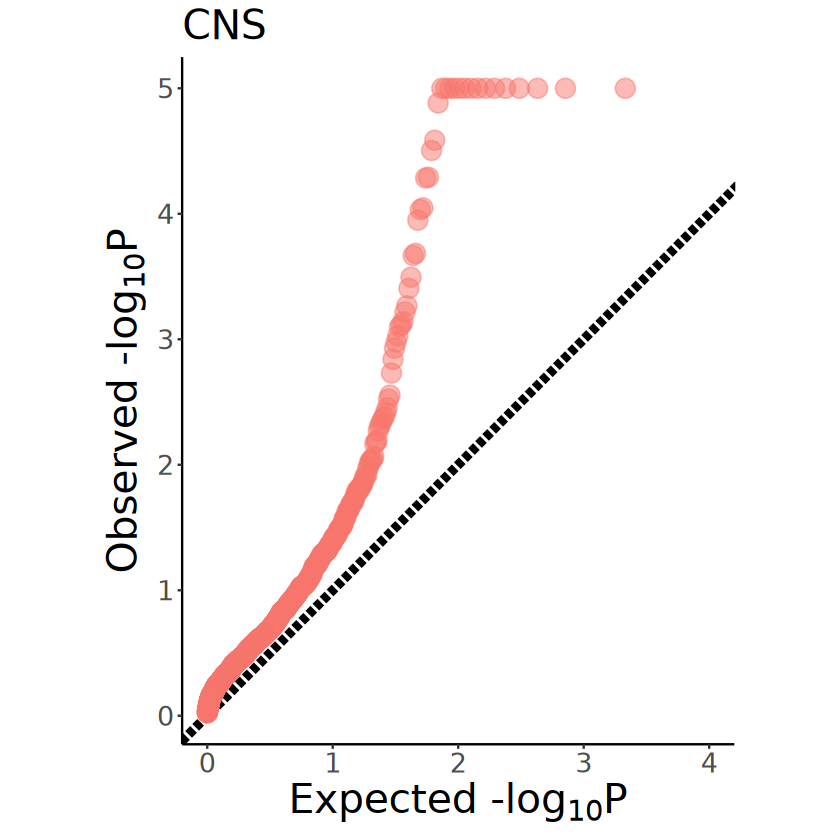

In [8]:
p <- mcubePlotPvalues(mcube_object@pvalues, "combined_pvalue") +
    xlim(c(0, 4)) +
    ggtitle("CNS") +
    coord_fixed(ratio = 1) +
    theme(
        plot.title = element_text(size = 24),
        axis.title.x = element_text(size = 24),
        axis.title.y = element_text(size = 24),
        axis.text.x = element_text(size = 16),
        axis.text.y = element_text(size = 16),
        legend.position = "none"
    )

ggsave(
    file = file.path(RESULT_PATH, paste0(celltype, "_combined_pvalue.pdf")),
    plot = p, width = 5, height = 5
)
p

In [9]:
# # For saving the plotly object as a static image with `kaleido`
# install.packages('reticulate')
# reticulate::install_miniconda()
# reticulate::conda_install('r-reticulate', 'python-kaleido')
# reticulate::conda_install('r-reticulate', 'plotly', channel = 'plotly')
# reticulate::use_miniconda('r-reticulate')

In [10]:
# Proportions in the 3D perspective
p <- mcubePlotPropCellType3D(
    mcube_object@proportions, mcube_object@coordinates, celltype, proportion_threshold = 0.5, 
    spot_size = 1.5, opacity_target = 0.8, opacity_background = 0.05,
    axis_rescale = c(1, 1, 1.5), plotly_eye = list(x = 0.2, y = -1.5, z = 1.6)
)
plotly::save_image(
    p, file.path(RESULT_PATH, paste0("proportion_", celltype, "_3D", ".pdf")),
    width = 600, height = 400, scale = 5
)
p

HTML widgets cannot be represented in plain text (need html)

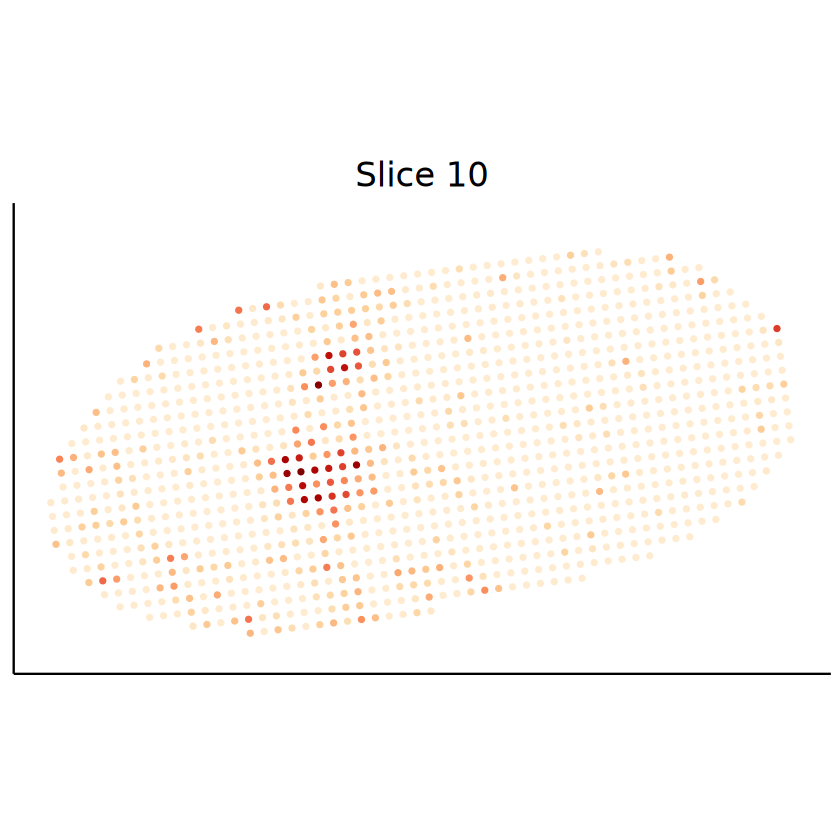

In [11]:
# Proportions in the 2D perspective
xlim <- range(mcube_object@coordinates[, "x"])
ylim <- range(mcube_object@coordinates[, "y"])
for (slice_idx in c(4, 6, 8, 10)) {
    spots_plot <- rownames(mcube_object@proportions)[
        mcube_object@batch_id == paste0("slice", slice_idx - 1)
    ]
    p <- mcubePlotPropCellType(
        mcube_object@proportions[spots_plot, ],
        mcube_object@coordinates[spots_plot, c("x", "y")],
        celltype = celltype,
        xlim = xlim, ylim = ylim,
    ) +
        labs(title = paste("Slice", slice_idx)) +
        theme(
            text = element_text(size = 1, hjust = 0.5),
            plot.title = element_text(size = 20, hjust = 0.5),
            axis.title = element_blank(),
            axis.text.x = element_blank(),
            axis.text.y = element_blank(),
            axis.ticks = element_blank(),
            legend.position = "none"
        )
    ggsave(
        file = file.path(RESULT_PATH, paste0("proportion_", celltype, "_slice", slice_idx, ".pdf")),
        plot = p, width = 4, height = 3
    )
}
p

In [12]:
demo_genes <- c("jim", "fax", "fabp", "CG14989", "14-3-3epsilon")
mcube_object@pvalues[[1]][demo_genes, ]
for (gene in demo_genes) {
    p <- mcubePlotExprCellType3D(
        object = mcube_object, gene = gene, celltype = celltype, proportion_threshold = 0.5, 
        spot_size = 1.5, opacity_target = 0.8, opacity_background = 0.05,
        axis_rescale = c(1, 1, 1.5), plotly_eye = list(x = 0.2, y = -1.5, z = 1.6)
    )
    plotly::save_image(
        p, file.path(RESULT_PATH, paste0(celltype, "_", gene, ".pdf")),
        width = 600, height = 400, scale = 5
    )
}
p

,linear,Gaussian_1,Gaussian_2,Gaussian_transformed_1,Gaussian_transformed_2,combined_pvalue
,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>
jim,2.010167e-08,8.367837e-22,7.263291e-23,0.006759942,0.004926118,7.263291e-23
fax,5.191350e-17,4.686686e-08,2.207457e-11,0.250094459,0.083622766,2.595669e-16
fabp,5.409936e-13,4.283279e-06,1.076104e-08,0.188860376,0.472094925,2.704836e-12
CG14989,1.448876e-09,9.559744e-10,2.231533e-11,0.042749653,0.012163526,1.074150e-10
14-3-3epsilon,6.733549e-09,7.401144e-04,8.598788e-05,0.031894092,0.200163921,3.366480e-08


HTML widgets cannot be represented in plain text (need html)

### Not considering slice-specific platform effects

In [13]:
mcube_object_batch_effects <- createMCUBE(
    counts = counts, coordinates = coordinates, 
    proportions = proportions_ST, library_sizes = library_sizes_ST, 
    covariates = NULL, batch_id = NULL, # Assume all spots from the same batch by setting batch_id as NULL
    reference = reference_ST,
    spots = spots_names,
    spot_effects = spot_effects_ST, platform_effects = NULL,
    celltype_test = celltype,
    project = "CNS"
)
mcube_object_batch_effects <- mcubeFitNull(mcube_object_batch_effects, max_cores = max_cores)
mcube_object_batch_effects <- mcubeTest(mcube_object_batch_effects, max_cores = max_cores)

saveRDS(
    mcube_object_batch_effects,
    file = file.path(
        RESULT_PATH,
        paste0(
            "mcube_", celltype,
            "_batch_effects",
            ".rds"
        )
    )
)
# mcube_object_batch_effects <- readRDS(
#     file = file.path(
#         RESULT_PATH,
#         paste0(
#             "mcube_", celltype,
#             "_batch_effects",
#             ".rds"
#         )
#     )
# )

The batch_id is not provided!
All spots are assumed to come from the same batch and share the same gene platform effects.

mcubeFilterCellTypes: Cell types CNS pass the celltype_threshold = 100.

mcubeFilterGenes: Filter genes based on relative expression with threshold = 5e-05.

The platform effects are not provided and need to be estimated from data!

Preprocessed data description: 14132 spots, 1650 genes, and 16 cell types in total. 546 spots and 1 cell types to analyze.

Number of cores used: 36.

mcubeKernel: length scale is set as 0.178073578880044 for the Gaussian kernel.

mcubeKernel: length scale is set as 0.251834070352474 for the Gaussian kernel.

mcubeKernel: length scale is set as 0.178073578880044 for the Gaussian_transformed kernel.

mcubeKernel: length scale is set as 0.251834070352474 for the Gaussian_transformed kernel.

Number of cores used: 36.



In [14]:
nrow(mcube_object_batch_effects@pvalues[[1]])

sig_genes <- mcubeGetSigGenes(mcube_object_batch_effects@pvalues)
nrow(sig_genes[[1]])
head(sig_genes[[1]])

[1] 1073

mcubeGetSigGenes: Set adjust_method as BH and alpha as 0.05.



[1] 51

,pvalue,adjusted_pvalue
,<dbl>,<dbl>
jim,1.534176e-28,1.646171e-25
Pdf,1.595727e-24,8.561076e-22
Atpalpha,7.771561e-16,2.779628e-13
RpL39,3.774758e-15,1.012579e-12
mt:ATPase6,6.245671e-12,1.340321e-09
CG13218,2.864797e-11,5.123212e-09


## Salivary gland

In [15]:
celltype <- "salivary gland"
spots_names <- rownames(proportions_ST)[proportions_ST[, celltype] > 0.5]

### Correcting for slice-specific platform effects

In [16]:
mcube_object <- createMCUBE(
    counts = counts, coordinates = coordinates, 
    proportions = proportions_ST, library_sizes = library_sizes_ST, 
    covariates = NULL, batch_id = batch_id,
    reference = reference_ST,
    spots = spots_names,
    spot_effects = spot_effects_ST, platform_effects = platform_effects_ST,
    celltype_test = celltype,
    project = "salivary gland"
)
mcube_object <- mcubeFitNull(mcube_object, max_cores = max_cores)
mcube_object <- mcubeTest(mcube_object, max_cores = max_cores)

mcubeFilterCellTypes: Cell types salivary gland pass the celltype_threshold = 100.

mcubeFilterGenes: Filter genes based on relative expression with threshold = 5e-05.

Preprocessed data description: 14132 spots, 803 genes, and 16 cell types in total. 176 spots and 1 cell types to analyze.

Number of cores used: 36.

mcubeKernel: length scale is set as 0.178073578880044 for the Gaussian kernel.

mcubeKernel: length scale is set as 0.251834070352474 for the Gaussian kernel.

mcubeKernel: length scale is set as 0.178073578880044 for the Gaussian_transformed kernel.

mcubeKernel: length scale is set as 0.251834070352474 for the Gaussian_transformed kernel.

Number of cores used: 36.



In [17]:
saveRDS(
    mcube_object,
    file = file.path(
        RESULT_PATH,
        paste0("mcube_", "salivary_gland", ".rds")
    )
)
# mcube_object <- readRDS(
#     file = file.path(
#         RESULT_PATH,
#         paste0("mcube_", "salivary_gland", ".rds")
#     )
# )

In [18]:
nrow(mcube_object@pvalues[[1]])

sig_genes <- mcubeGetSigGenes(mcube_object@pvalues)
nrow(sig_genes[[1]])
head(sig_genes[[1]])

write.table(
    rownames(sig_genes[[1]]),
    file = file.path(
        RESULT_PATH,
        paste0("SVG_", "salivary_gland", ".txt")
    ),
    quote = FALSE, row.names = FALSE, col.names = FALSE
)

[1] 554

mcubeGetSigGenes: Set adjust_method as BH and alpha as 0.05.



[1] 23

,pvalue,adjusted_pvalue
,<dbl>,<dbl>
CG13159,7.600075e-18,4.210441e-15
nur,3.097522e-14,8.580137e-12
CG13063,1.161382e-11,2.144686e-09
CG43181,2.824307e-11,3.911666e-09
CG14453,1.237093e-07,1.370699e-05
CG6763,3.751318e-07,3.463717e-05


Coordinate system already present. Adding new coordinate system, which will
replace the existing one.


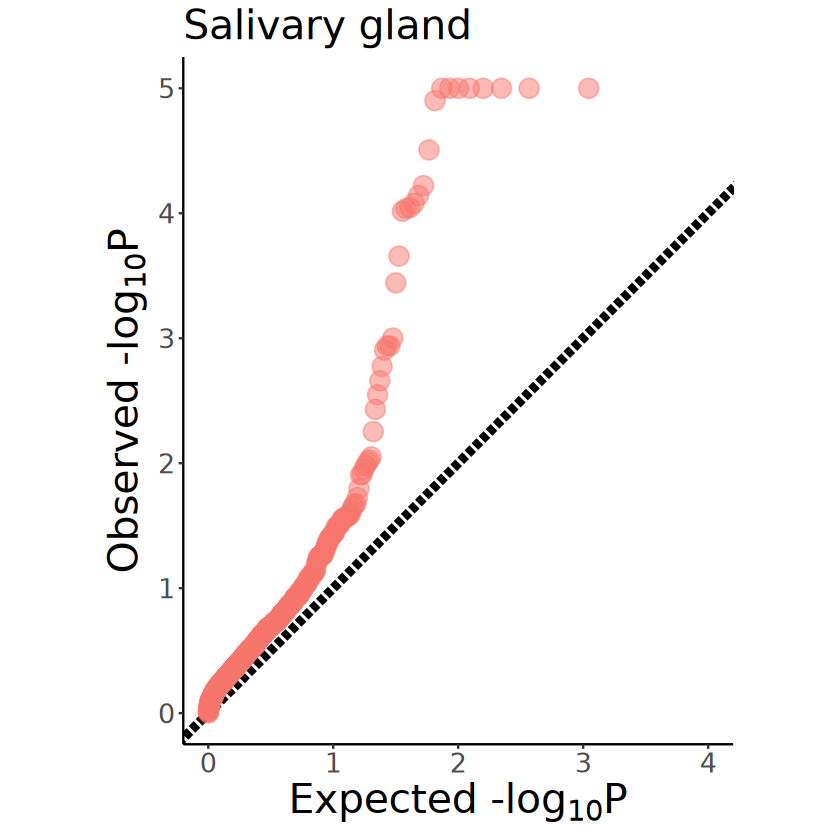

In [19]:
p <- mcubePlotPvalues(mcube_object@pvalues, "combined_pvalue") +
    xlim(c(0, 4)) +
    ggtitle("Salivary gland") +
    coord_fixed(ratio = 1) +
    theme(
        plot.title = element_text(size = 24),
        axis.title.x = element_text(size = 24),
        axis.title.y = element_text(size = 24),
        axis.text.x = element_text(size = 16),
        axis.text.y = element_text(size = 16),
        legend.position = "none"
    )

ggsave(
    file = file.path(RESULT_PATH, paste0("salivary_gland", "_combined_pvalue.pdf")),
    plot = p, width = 5, height = 5
)
p

In [20]:
# Proportions in the 3D perspective
p <- mcubePlotPropCellType3D(
    mcube_object@proportions, mcube_object@coordinates, celltype, proportion_threshold = 0.5, 
    spot_size = 1.5, opacity_target = 0.8, opacity_background = 0.05,
    axis_rescale = c(1, 1, 1.5), plotly_eye = list(x = -0.1, y = -1.6, z = 1.8)
)
plotly::save_image(
    p, file.path(RESULT_PATH, paste0("proportion_", "salivary_gland", "_3D", ".pdf")),
    width = 600, height = 400, scale = 5
)
p

HTML widgets cannot be represented in plain text (need html)

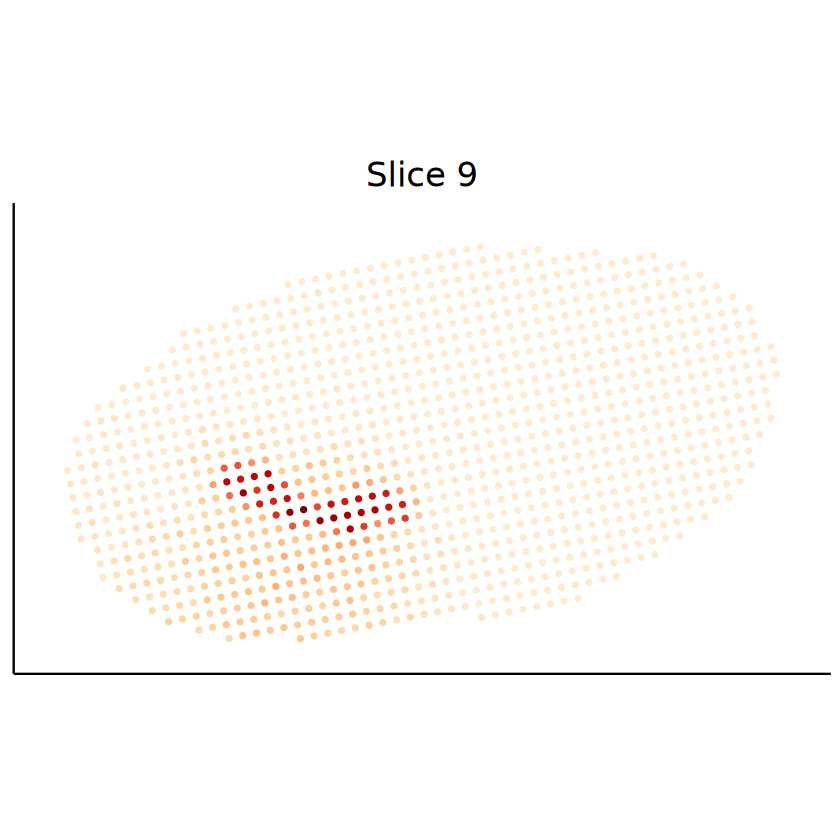

In [21]:
# Proportions in the 2D perspective
xlim <- range(mcube_object@coordinates[, "x"])
ylim <- range(mcube_object@coordinates[, "y"])
for (slice_idx in c(3, 5, 7, 9)) {
    spots_plot <- rownames(mcube_object@proportions)[
        mcube_object@batch_id == paste0("slice", slice_idx - 1)
    ]
    p <- mcubePlotPropCellType(
        mcube_object@proportions[spots_plot, ],
        mcube_object@coordinates[spots_plot, c("x", "y")],
        celltype = celltype,
        xlim = xlim, ylim = ylim,
    ) +
        labs(title = paste("Slice", slice_idx)) +
        theme(
            text = element_text(size = 1, hjust = 0.5),
            plot.title = element_text(size = 20, hjust = 0.5),
            axis.title = element_blank(),
            axis.text.x = element_blank(),
            axis.text.y = element_blank(),
            axis.ticks = element_blank(),
            legend.position = "none"
        )
    ggsave(
        file = file.path(RESULT_PATH, paste0("proportion_", "salivary_gland", "_slice", slice_idx, ".pdf")),
        plot = p, width = 4, height = 3
    )
}
p

In [25]:
demo_genes <- c("CG13159", "nur", "CG13063", "CG43181", "CG14453")
mcube_object@pvalues[[1]][demo_genes, ]
for (gene in demo_genes) {
    p <- mcubePlotExprCellType3D(
        object = mcube_object, gene = gene, celltype = celltype, proportion_threshold = 0.5, 
        spot_size = 1.5, opacity_target = 0.8, opacity_background = 0.05,
        plotly_eye = list(x = -0.1, y = -1.6, z = 1.8)
    )
    plotly::save_image(
        p, file.path(RESULT_PATH, paste0("salivary_gland", "_", gene, ".pdf")),
        width = 600, height = 400, scale = 5
    )
}
p

,linear,Gaussian_1,Gaussian_2,Gaussian_transformed_1,Gaussian_transformed_2,combined_pvalue
,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>
CG13159,3.870184e-14,1.258466e-14,7.600075e-18,1.545397e-04,2.193474e-04,7.600075e-18
nur,1.378794e-09,7.951762e-13,6.208081e-15,4.748158e-10,3.094759e-08,3.097522e-14
CG13063,1.010445e-09,4.260559e-09,2.329369e-12,7.491070e-02,6.351853e-02,1.161382e-11
CG43181,1.418116e-06,5.926662e-08,5.649123e-12,1.909359e-05,1.765199e-05,2.824307e-11
CG14453,5.202322e-01,3.907679e-08,6.744598e-08,6.660536e-02,2.034389e-01,1.237093e-07


HTML widgets cannot be represented in plain text (need html)

### Not considering slice-specific platform effects

In [23]:
mcube_object_batch_effects <- createMCUBE(
    counts = counts, coordinates = coordinates, 
    proportions = proportions_ST, library_sizes = library_sizes_ST, 
    covariates = NULL, batch_id = NULL, # Assume all spots from the same batch by setting batch_id as NULL
    reference = reference_ST,
    spots = spots_names,
    spot_effects = spot_effects_ST, platform_effects = NULL,
    celltype_test = celltype,
    project = "salivary gland"
)
mcube_object_batch_effects <- mcubeFitNull(mcube_object_batch_effects,max_cores = max_cores)
mcube_object_batch_effects <- mcubeTest(mcube_object_batch_effects, max_cores = max_cores)

saveRDS(
    mcube_object_batch_effects,
    file = file.path(
        RESULT_PATH,
        paste0(
            "mcube_", "salivary_gland",
            "_batch_effects",
            ".rds"
        )
    )
)
# mcube_object_batch_effects <- readRDS(
#     file = file.path(
#         RESULT_PATH,
#         paste0(
#             "mcube_", "salivary_gland",
#             "_batch_effects",
#             ".rds"
#         )
#     )
# )

The batch_id is not provided!
All spots are assumed to come from the same batch and share the same gene platform effects.

mcubeFilterCellTypes: Cell types salivary gland pass the celltype_threshold = 100.

mcubeFilterGenes: Filter genes based on relative expression with threshold = 5e-05.

The platform effects are not provided and need to be estimated from data!

Preprocessed data description: 14132 spots, 803 genes, and 16 cell types in total. 176 spots and 1 cell types to analyze.

Number of cores used: 36.

mcubeKernel: length scale is set as 0.178073578880044 for the Gaussian kernel.

mcubeKernel: length scale is set as 0.251834070352474 for the Gaussian kernel.

mcubeKernel: length scale is set as 0.178073578880044 for the Gaussian_transformed kernel.

mcubeKernel: length scale is set as 0.251834070352474 for the Gaussian_transformed kernel.

Number of cores used: 36.



In [24]:
nrow(mcube_object_batch_effects@pvalues[[1]])

sig_genes <- mcubeGetSigGenes(mcube_object_batch_effects@pvalues)
nrow(sig_genes[[1]])
head(sig_genes[[1]])

[1] 554

mcubeGetSigGenes: Set adjust_method as BH and alpha as 0.05.



[1] 33

,pvalue,adjusted_pvalue
,<dbl>,<dbl>
CG13063,7.779632e-35,4.309916e-32
CG13159,4.801781e-22,1.330093e-19
nur,2.595318e-16,4.792688e-14
CG18649,4.218847e-15,5.843104e-13
CG43181,5.281331e-13,5.851715e-11
CG13738,2.631670e-09,2.429908e-07
